
- move to reconciliation directory + readme.md
    - where on the grid are the old data, new data
- generate two stata files (used for Table 4)
    - v19.1

- rerun topic model
    - directly run on new data
    - deterministic
    - greedily allocate unclassified topics
    - match the new topics with the old topics: 7x7 cosine similarity matrix (old x new, find argmax of rows/cols greedily and exclusively)
    - sum the top similarities (hopefully six)
    - find the distribution of different seeds

- change binary to frequency vectors when computing cosine similarity between topic allocations:
    - 0 => 0
    - 1 => dtm.sum()/dtm.sum().sum()
- greedily matching the old:
    - max => exclude col and row => max => ...
    - define score of a new topic model = mean(7 scores)
- repeat for 500+ times:
    - discard !=7 topics
    - find the new topic model matching the old most
    - find the new topic model with highest modularity
    - wordcloud
    
- change binary old to weighted new
- report percentile
- allocate 54 words using Clustering_C
    - random sequence to max modularity

In [1]:
import igraph as ig
import pandas as pd
import numpy as np
from scipy import sparse
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import torch

import random
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')

import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
from wordcloud import WordCloud
seed = 12345

In [2]:
def get_clusters(seed):
    random.seed(seed)
    return graph.community_multilevel(weights='cosine')

def get_topic_vec(cluster, weight=True):
    mask = np.zeros(num_words, dtype=bool)
    mask[cluster] = True
    if not weight:
        return mask
    else:
        topic_vec = np.zeros(num_words)
        topic_vec[mask] = [word2weight[word] for word in m.columns[cluster]]
        return topic_vec
    
def get_matching_score(matrix, num_pairs=None, return_idx=False):
    
    """
    return the mean of greedily-searched best matching pairs between old and new topic vectors 
    based on max cos-similarity
    """
    
    if not num_pairs:
        num_pairs = min(matrix.shape)
        
    max_values, max_value_indices = [], []
    for _ in range(num_pairs):
        max_value_idx = np.unravel_index(np.argmax(matrix), matrix.shape)
        max_value = matrix[max_value_idx]
        max_values.append(max_value)
        matrix[max_value_idx[0], :] = -np.inf
        matrix[:, max_value_idx[1]] = -np.inf
        if return_idx:
            max_value_indices.append(max_value_idx)

    return max_values, max_value_indices

In [3]:
m = pd.read_csv("/shared/share_mamaysky-glasserman/energy_drivers/2023/DataProcessing/cosine/cosine.csv", 
                 header=0, index_col=0)
num_words = len(m.columns)
assert num_words == 387

df = pd.read_csv('clustering_C.csv')
words = df['word'].to_list()
idx_387 = [words.index(word_387) for word_387 in m.columns]
old_topics = df.iloc[idx_387]['Topic'].to_list()
n_topics_old = max(old_topics)

dtmPath = '/shared/share_mamaysky-glasserman/energy_drivers/2023/DataProcessing/concat/dtm_concatenate.npz'
dtm = sparse.load_npz(dtmPath)[:,idx_387]
weights = np.array(dtm.sum(axis=0)/dtm.sum())[0]
word2weight = {k: v for k, v in zip(m.columns, weights)}

df_old = pd.read_csv('clustering_C.csv')
old = (1 - df_old.pivot_table(index='word', columns='Topic').isna().loc[m.columns]).values.T
membership_old = (df_old.set_index('word').loc[m.columns]['Topic'] - 1).to_list()
arr = np.where(old == 1)
clusters_old = [arr[1][np.where(arr[0] == i)] for i in range(n_topics_old)]
topic_vec_old = [get_topic_vec(cluster) for cluster in clusters_old]

# https://igraph.org/python/doc/api/igraph.Graph.html#Weighted_Adjacency
graph = ig.Graph.Weighted_Adjacency(m.values, mode='undirected', attr='cosine', loops=False)
mod_old = graph.modularity(membership_old, weights='cosine')

Sum of weights over all topics: 1.0000
Greedy max values of binary   : [0.456 0.388 0.368 0.31  0.257 0.224 0.148]
Greedy max values of weighted : [1.    0.999 0.997 0.979 0.948 0.642 0.313]


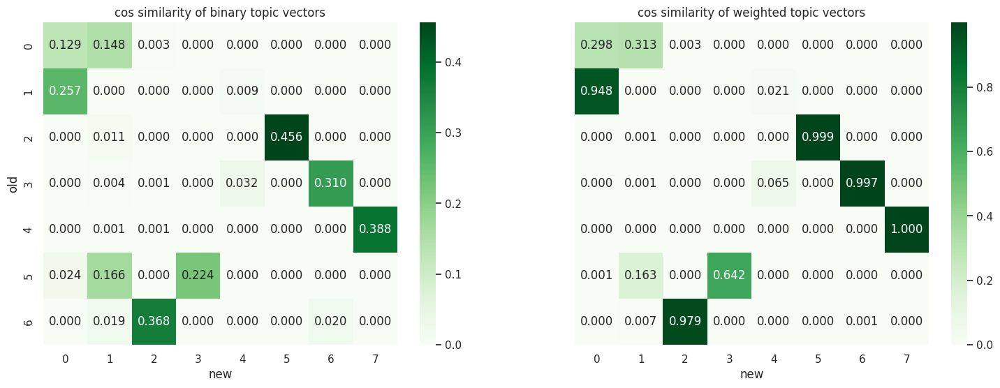

In [4]:
# sanity check: reproducibility, sum of topic vectors, greedy algo

c = get_clusters(1)
topic_vec_binary = [get_topic_vec(cluster, weight=False) for cluster in c]
topic_vec_weighted = [get_topic_vec(cluster) for cluster in c]
assert len(c.sizes()) == 8
print(f'Sum of weights over all topics: {np.sum(topic_vec_weighted):.4f}')
cs_binary = cosine_similarity(topic_vec_old, topic_vec_binary)
cs_weighted = cosine_similarity(topic_vec_old, topic_vec_weighted)

fig, ax = plt.subplots(figsize=(18,6), nrows=1, ncols=2)
sns.heatmap(cs_binary, cmap='Greens', ax=ax[0], annot=True, fmt='.3f')
ax[0].set_title('cos similarity of binary topic vectors')
sns.heatmap(cs_weighted, cmap='Greens', ax=ax[1], annot=True, fmt='.3f')
ax[1].set_title('cos similarity of weighted topic vectors')
ax[1].set_yticklabels([])
ax[0].set_xlabel('new')
ax[0].set_ylabel('old')
ax[1].set_xlabel('new')

print(f'Greedy max values of binary   : {np.round(get_matching_score(cs_binary)[0],3)}')
print(f'Greedy max values of weighted : {np.round(get_matching_score(cs_weighted)[0],3)}')

In [5]:
# # sanity check: count the number of 7-topic allocations; distribution of modularity

# res = {}
# res['acc'], res['pre'], res['rec'], res['f1'] = {'raw':[],'permuted':[]}, {'raw':[],'permuted':[]}, \
#                                                 {'raw':[],'permuted':[]}, {'raw':[],'permuted':[]}
# res['size'], res['mod'], res['cs'] = [], [], []

# #for s in tqdm(range(1234)):
# for s in tqdm(range(seed)):
    
#     c = get_clusters(s)
#     res['size'].append(len(c.sizes()))
#     res['mod'].append(c.modularity)
 
#     topic_vec = [get_topic_vec(cluster) for cluster in c]
#     cs_matrix = cosine_similarity(topic_vec_old, topic_vec)
#     cs_list, old2new = get_matching_score(cs_matrix, return_idx=True)
#     res['cs'].append(np.mean(cs_list))
    
#     res['acc']['raw'].append(accuracy_score(membership_old, c.membership))
#     res['pre']['raw'].append(precision_score(membership_old, c.membership, average='weighted'))
#     res['rec']['raw'].append(recall_score(membership_old, c.membership, average='macro'))
#     res['f1']['raw'].append(f1_score(membership_old, c.membership, average='weighted'))
    
#     new2old = {new:old for old, new in old2new}
#     membership_new = [new2old.get(new,n_topics_old) for new in c.membership]
#     res['acc']['permuted'].append(accuracy_score(membership_old, membership_new))
#     res['pre']['permuted'].append(precision_score(membership_old, membership_new, average='weighted'))
#     res['rec']['permuted'].append(recall_score(membership_old, membership_new, average='macro'))
#     res['f1']['permuted'].append(f1_score(membership_old, membership_new, average='weighted'))
    
# torch.save(res, 'res.pt')

100%|█████████████████████████████████████| 12345/12345 [10:37<00:00, 19.36it/s]


In [5]:
res = torch.load('res.pt')

In [6]:
seed_best_mod = int(np.argmax(res['mod']))
seed_best_match = int(np.argmax(res['cs']))
seed_best_acc = int(np.argmax(res['acc']['permuted']))
print(f'seed for largest modularity    : {seed_best_mod}') # 6970
print(f'seed for best match (cs)       : {seed_best_match}') # 9139

for metric_type in ['raw', 'permuted']:
    for metric in ['acc', 'pre', 'rec', 'f1']:
        print(f'seed for best match ({metric} {metric_type})  : {int(np.argmax(res[metric][metric_type]))}') 
        
# sanity check: reproducibility (all randomness comes from "random")
assert res['mod'][seed_best_mod] == get_clusters(seed_best_mod).modularity

seed for largest modularity    : 6970
seed for best match (cs)       : 9139
seed for best match (acc raw)  : 8837
seed for best match (pre raw)  : 1290
seed for best match (rec raw)  : 9217
seed for best match (f1 raw)  : 8837
seed for best match (acc permuted)  : 8167
seed for best match (pre permuted)  : 6672
seed for best match (rec permuted)  : 8167
seed for best match (f1 permuted)  : 8167


In [7]:
def get_pvalue_mod(seed, mod, filter_cluster=False):
    c = get_clusters(seed)
    if filter_cluster:
        mod = [m for m, s in zip(mod, res['size']) if s == n_topics_old]
    return np.mean(np.array(mod) > c.modularity)

for filter_cluster in [True, False]:
    print(f'Only consider {n_topics_old}-cluster allocations: {filter_cluster}')
    print(f"Upper-tail p-value of largest modularity: {get_pvalue_mod(seed_best_mod, res['mod'], filter_cluster):.4f}")
    print(f"Upper-tail p-value of best match (cs)   : {get_pvalue_mod(seed_best_match, res['mod'], filter_cluster):.4f}")
    print(f"Upper-tail p-value of best match (acc)  : {get_pvalue_mod(seed_best_acc, res['mod'], filter_cluster):.4f}")

Only consider 7-cluster allocations: True
Upper-tail p-value of largest modularity: 0.0000
Upper-tail p-value of best match (cs)   : 0.7969
Upper-tail p-value of best match (acc)  : 0.8040
Only consider 7-cluster allocations: False
Upper-tail p-value of largest modularity: 0.0000
Upper-tail p-value of best match (cs)   : 0.7714
Upper-tail p-value of best match (acc)  : 0.7806


In [8]:
def get_upper_mask(list_all, percent=95):
    threshold = np.percentile(list_all, percent)
    return threshold, [x > threshold for x in list_all]

def plot_metric_mod(metric_arr, mod_arr, acc_max_index, 
                    xlabel, title, mask=None, plot_type='threshold', ax=None):
    if mask:
        metric_arr = metric_arr[mask]
        mod_arr = mod_arr[mask]
    if not ax:
        fig, ax = plt.subplots(figsize=(3,2))
    ax.plot(metric_arr, mod_arr, '.')

    mod_max_index = np.argmax(mod_arr)
    for idx in [acc_max_index, mod_max_index]:
        ax.plot(metric_arr[idx], mod_arr[idx], 'o')
    
    metric_upper_threshold, metric_upper_mask = get_upper_mask(metric_arr)
    mod_upper_threshold, mod_upper_mask = get_upper_mask(mod_arr)
    if plot_type == 'scatter':
        ax.scatter(metric_arr[metric_upper_mask], mod_arr[metric_upper_mask])
        ax.scatter(metric_arr[mod_upper_mask], mod_arr[mod_upper_mask])
    elif plot_type == 'threshold':
        ax.axvline(metric_upper_threshold)
        ax.axhline(mod_upper_threshold)
    ax.set_ylabel('modularity')
    ax.set_xlabel(xlabel)
    ax.set_title(title)
    ax.yaxis.set_visible(False)
    ax.set_ylim(min(res['mod']), max(res['mod'])+0.001)
    
    
def plot_top_percentile(metric_type, percent_list=[0, 50, 75, 80, 90, 95, 99], 
                        filter_cluster=False, initial_filter='acc', extra_filter=None,
                        plot_metric_list=['acc','pre','rec']):
    
    fig, ax = plt.subplots(figsize=(18,24), nrows=len(plot_metric_list)+1, ncols=len(percent_list))
    for i, percent in enumerate(percent_list):
        initial_threshold = np.percentile(res[initial_filter][metric_type], percent)
        mask = [i>=initial_threshold for i in res[initial_filter][metric_type]]
        title = f'{initial_filter}>={initial_threshold:.2f}'
            
        if filter_cluster:
            mask = list(np.fmin(mask, [s==n_topics_old for s in res['size']]))
        
        if extra_filter:
            extra_threshold = np.percentile(res[extra_filter][metric_type], percent)
            mask = [i>=initial_threshold and j>=extra_threshold for i,j in zip(res[initial_filter][metric_type], res[extra_filter][metric_type])]
            title += f', {extra_filter}>={extra_threshold:.2f}'
        
        acc_max_index = np.argmax(np.array(res['acc'][metric_type])[mask])

        for j, metric in enumerate(plot_metric_list):
            plot_metric_mod(np.array(res[metric][metric_type]), np.array(res['mod']), acc_max_index,
                        xlabel=f'{metric_type} {metric}', title=title, mask=mask, ax=ax[j][i])
        plot_metric_mod(np.array(res['cs']), np.array(res['mod']), acc_max_index,
                        xlabel=f'cosine similarity', title=title, mask=mask, ax=ax[-1][i])
    return max(np.array(res['mod'])[mask])

0.37134003994906184

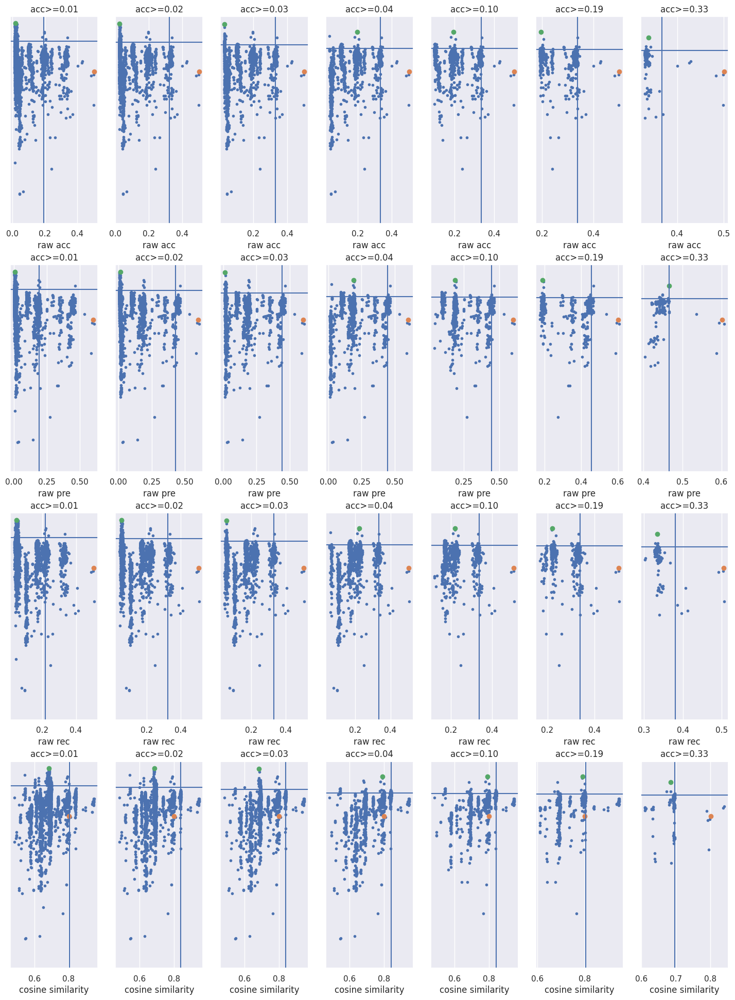

In [12]:
plot_top_percentile(metric_type='raw', initial_filter='acc', filter_cluster=True)

0.3704123378036232

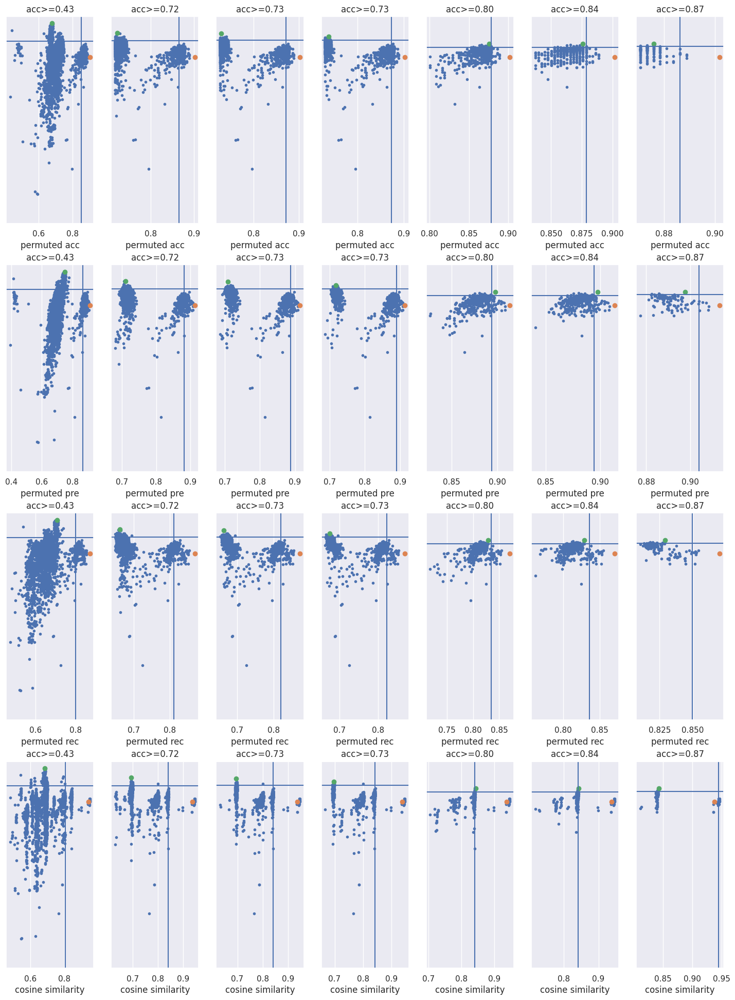

In [13]:
plot_top_percentile(metric_type='permuted', initial_filter='acc', filter_cluster=True)

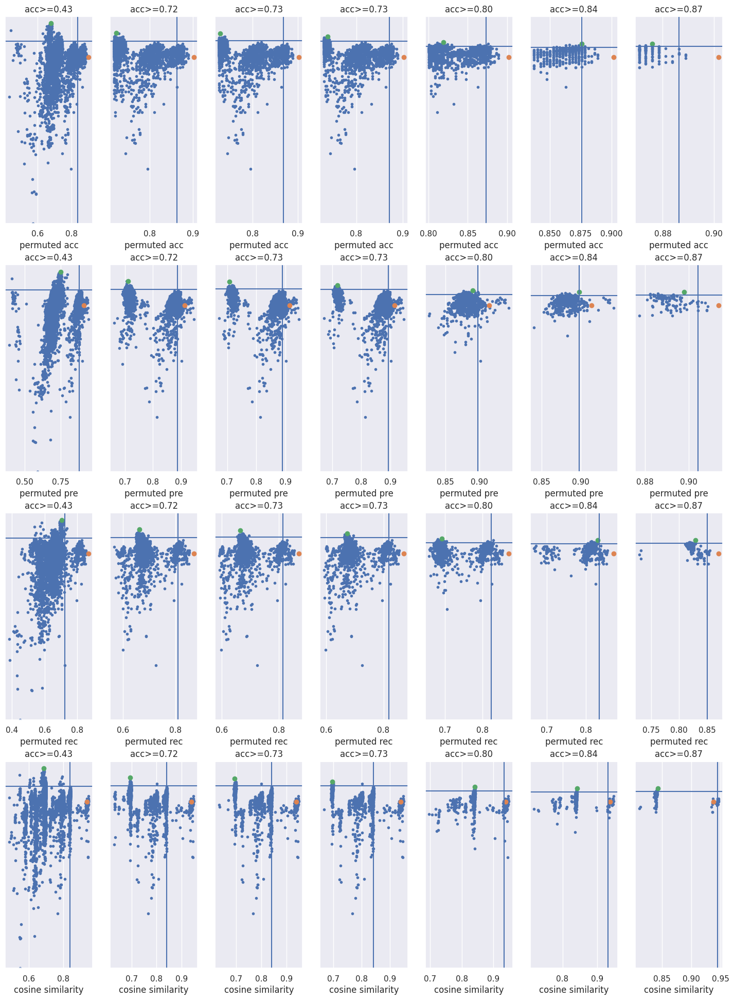

In [24]:
best_mod = plot_top_percentile(metric_type='permuted', initial_filter='acc', filter_cluster=False)
assert sum([i == best_mod for i in res['mod']]) == 1
seed_best_selected = res['mod'].index(best_mod)
plt.savefig('similarity.pdf')

In [19]:
var_list = ['Co', 'Gom', 'Env', 'Epg', 'Bbl', 'Rpc', 'Ep']

def plot_topic_wordclouds(word_weights, ncols=2, topic_names=var_list):
    nrows = int(np.ceil(len(word_weights)/ncols))
    fig, ax = plt.subplots(figsize=(12,24), nrows=nrows, ncols=ncols)
    for i, (w, topic) in enumerate(zip(word_weights, topic_names)):
        wordcloud = WordCloud(width = 400, height = 400,
                          background_color ='white',
                          random_state=seed).generate_from_frequencies(w)
        ax[int(i/ncols)][i%ncols].imshow(wordcloud)
        ax[int(i/ncols)][i%ncols].axis('off')
        ax[int(i/ncols)][i%ncols].set_title(topic)
    
    # hide the last ax
    ax[-1, -1].set_visible(False)
    
def get_word_weights(c):
    topic_vec = [get_topic_vec(cluster) for cluster in c]
    cs = cosine_similarity(topic_vec_old, topic_vec)
    _, old2new = get_matching_score(cs, return_idx=True)

    assert len(old2new) == 7
    word_weights = list(range(len(old2new)))
    for old, new in old2new:
        word_weights[old] = {k: v for k, v in zip(m.columns, topic_vec[new])}
    return word_weights

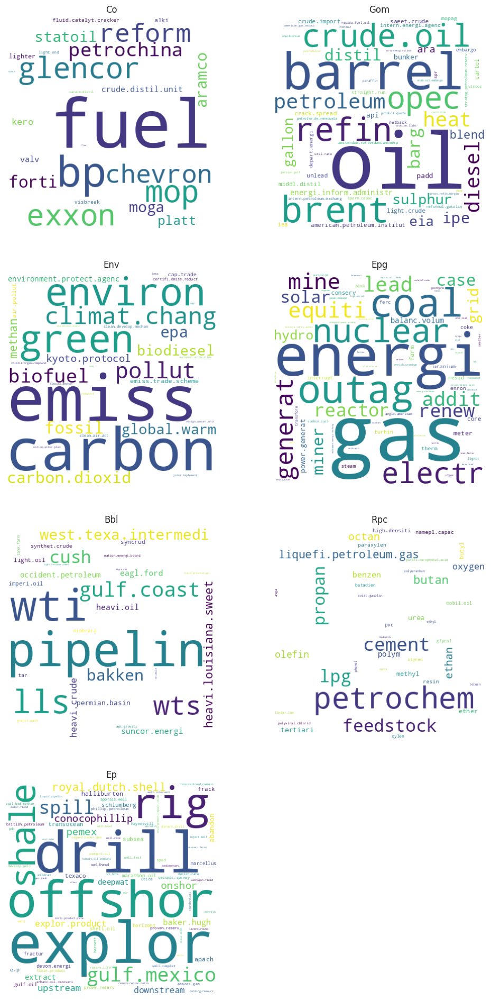

In [20]:
# best match (8 clusters)
c = get_clusters(seed_best_match)
plot_topic_wordclouds(get_word_weights(c))
plt.savefig('clouds best match.pdf')

In [21]:
ig.plot(c, vertex_size=15, vertex_label=old_topics)

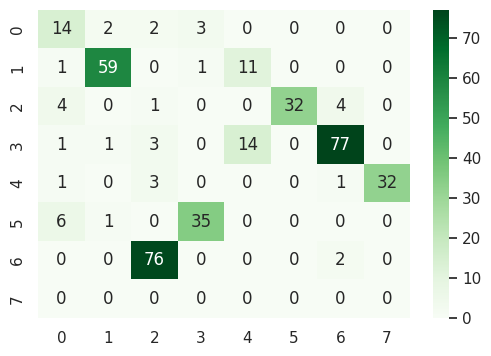

In [31]:
fig, ax = plt.subplots(figsize=(6,4))
sns.heatmap(confusion_matrix(membership_old, c.membership), ax=ax, annot=True, cmap='Greens');

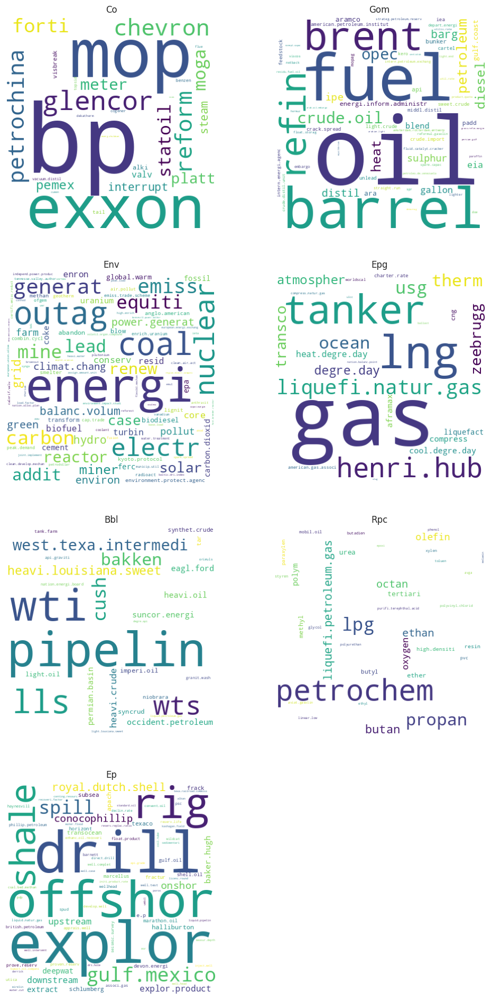

In [22]:
# best mod
c = get_clusters(seed_best_mod)
plot_topic_wordclouds(get_word_weights(c))
plt.savefig('clouds best mod.pdf')

In [23]:
ig.plot(c, vertex_size=15, vertex_label=old_topics)

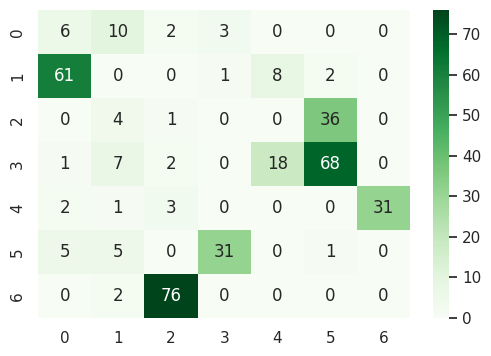

In [30]:
fig, ax = plt.subplots(figsize=(6,4))
sns.heatmap(confusion_matrix(membership_old, c.membership), ax=ax, annot=True, cmap='Greens');

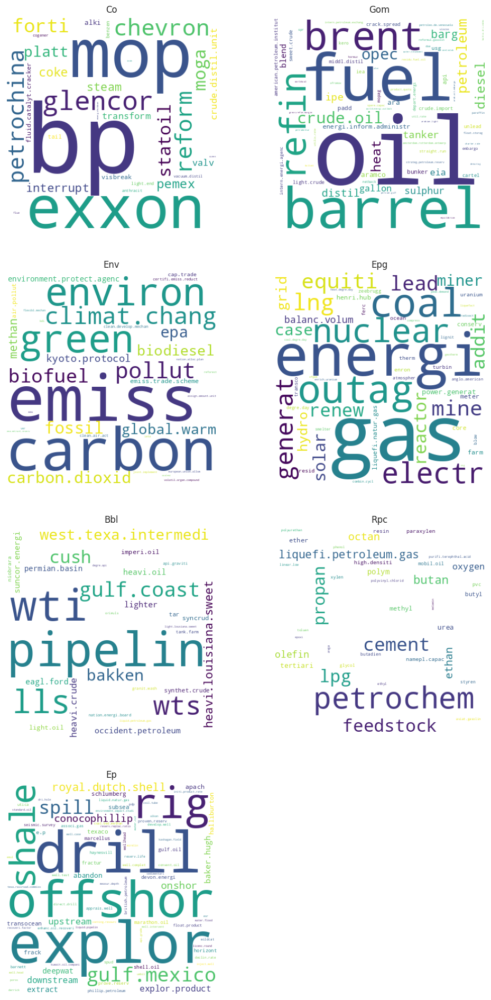

In [33]:
# best selected
c = get_clusters(seed_best_selected)
plot_topic_wordclouds(get_word_weights(c))
plt.savefig('clouds best selected.pdf')

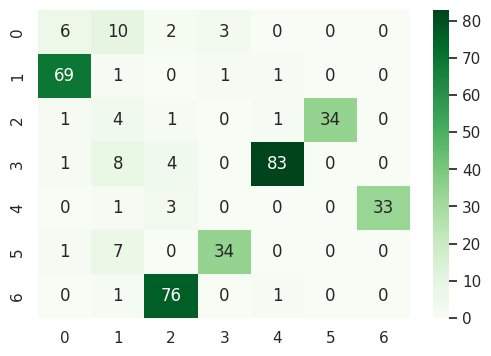

In [34]:
fig, ax = plt.subplots(figsize=(6,4))
sns.heatmap(confusion_matrix(membership_old, c.membership), ax=ax, annot=True, cmap='Greens');

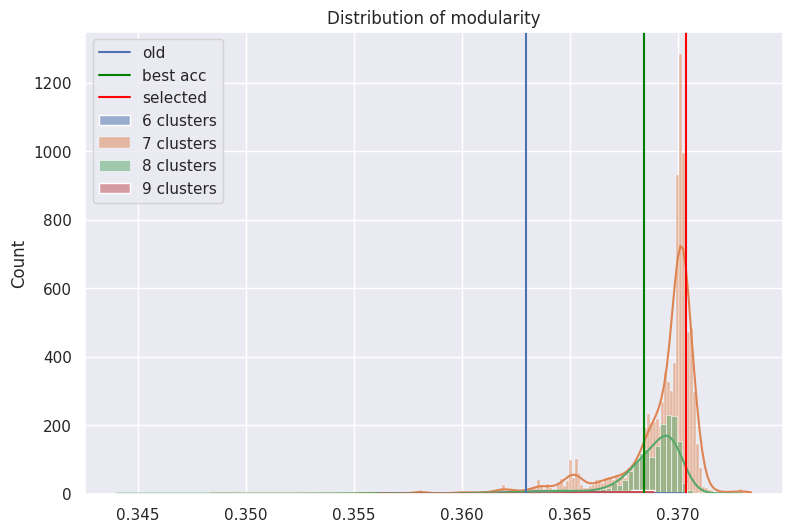

In [39]:
fig, ax = plt.subplots(figsize=(9,6))
for i in range(min(res['size']), max(res['size'])+1):
    mod_size = [m for m, s in zip(res['mod'], res['size']) if s == i]
    sns.histplot(mod_size, kde=True, ax=ax, label=f'{i} clusters')
ax.axvline(mod_old, label='old')
ax.axvline(get_clusters(seed_best_acc).modularity, color='green', label='best acc')
ax.axvline(c.modularity, color='red', label='selected')
ax.set_title('Distribution of modularity')
ax.legend()
ax.legend()
plt.savefig('mod distribution.pdf')

In [40]:
seed_best_selected

10344